## Shell Contact Example

In [1]:
# !pip install debugpy

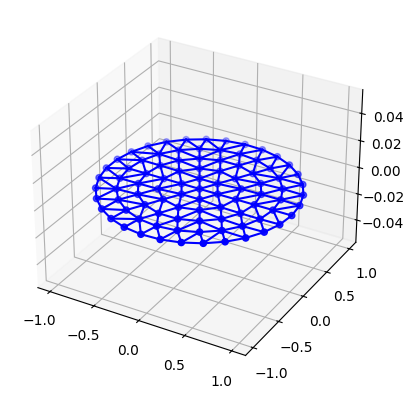

0


In [2]:
import numpy as np

import dismech


geom = dismech.GeomParams(rod_r0=0.005,
                          shell_h=0.005)

material = dismech.Material(density=1200,
                            youngs_rod=0,
                            youngs_shell=2e8,
                            poisson_rod=0,
                            poisson_shell=0.5)

shell_contact_sim = dismech.SimParams(static_sim=False,
                                  two_d_sim=False,   # no twisting
                                  use_mid_edge=False,
                                  use_line_search=True,
                                  show_floor=False,
                                  log_data=True,
                                  log_step=1,
                                  dt=1e-3,
                                  max_iter=100,
                                  total_time=5,
                                  plot_step=1,
                                  tol=1e-4,
                                  ftol=1e-4,
                                  dtol=1e-2)

env = dismech.Environment()
env.add_force('gravity', g=np.array([0.0, 0.0, -9.81]))
# env.add_force('selfContact', delta=0.01*2*5e-3, h=5e-3)
env.add_force('selfContact', delta=1e-4, h=5e-3, kc=1)
env.add_force('damping', eta=1)
env.add_force('hydrodynamics', rho=1.2, cd=50)
#env.set_static()  

# geo = dismech.Geometry.from_txt('input hemisphere more dense.txt')
geo = dismech.Geometry.from_txt('input_circle_python.txt')
# geo = dismech.Geometry.from_txt('input_circle_python_denser.txt')

robot = dismech.SoftRobot(geom, material, geo, shell_contact_sim, env)

# fixed_point = np.array(np.where(
#     robot.state.q[robot.node_dof_indices].reshape(-1, 3)[:, 2] >= 0.99)[0])
fixed_point = 0
robot = robot.fix_nodes(fixed_point)

print(fixed_point)
# u = robot.state.u
# u[11] = -0.5
# u[14] = -0.5
# u[17] = -0.5

In [3]:
print("# nodes: ", np.shape(robot.nodes))
print("# faces: ", np.shape(robot.face_nodes_shell))

# nodes:  (92, 3)
# faces:  (151, 3)


### Time Stepping

In [4]:
stepper = dismech.ImplicitEulerTimeStepper(robot)



delta: 0.02
h: 1.0
K1: 750.0
scale:  200.0
kc:  1
upper limit for quadratic: 1.98
upper limit for smooth: 2.02


In [5]:
robots = stepper.simulate()

qs = np.stack([robot.state.q for robot in robots])

iter: 1, error: 20.057
current_time:  0.001
iter: 1, error: 39.826
iter: 2, error: 0.002
current_time:  0.002
iter: 1, error: 59.311
iter: 2, error: 0.004
current_time:  0.003
iter: 1, error: 78.515
iter: 2, error: 0.008
current_time:  0.004
iter: 1, error: 97.440
iter: 2, error: 0.012
current_time:  0.005
iter: 1, error: 116.091
iter: 2, error: 0.016
current_time:  0.006
iter: 1, error: 134.469
iter: 2, error: 0.022
current_time:  0.007
iter: 1, error: 152.579
iter: 2, error: 0.028
current_time:  0.008
iter: 1, error: 170.422
iter: 2, error: 0.035
current_time:  0.009000000000000001
iter: 1, error: 188.001
iter: 2, error: 0.042
current_time:  0.01
iter: 1, error: 205.321
iter: 2, error: 0.050
current_time:  0.011
iter: 1, error: 222.383
iter: 2, error: 0.058
current_time:  0.012
iter: 1, error: 239.189
iter: 2, error: 0.066
current_time:  0.013000000000000001
iter: 1, error: 255.744
iter: 2, error: 0.075
current_time:  0.014
iter: 1, error: 272.048
iter: 2, error: 0.084
current_time: 

In [6]:
t = np.arange(robot.sim_params.total_time, step=robot.sim_params.dt)
options = dismech.AnimationOptions(title='Shell contact p2p', plot_step=10)

fig = dismech.get_interactive_animation_plotly(robot, t, qs, options)
fig.show()

501


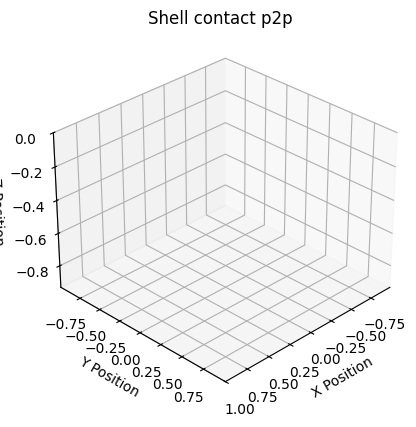

In [7]:
ani = dismech.get_animation(robot, t, qs, options)
ani.save('shell_hemisphere_self_contact.gif')

In [8]:
from src.dismech.logging import logDataForRendering
print(np.shape(t.reshape(-1, 1)), np.shape(qs))
rod_data, shell_data = logDataForRendering(qs, t.reshape(-1, 1), robot, len(t), robot.sim_params.static_sim, robot.map_node_to_dof)


(5000, 1) (5000, 276)
(5000, 277) (5000, 1) (5000, 276)
(151, 3)
151


In [9]:
from src.dismech.logging import export_rod_shell_data
export_rod_shell_data(robot, rod_file='rawDataRod.txt', shell_file='rawDataShell.txt',
                          rod_js='rodData.js', shell_js='shellData.js',
                          rod_radius=0.1, scaleFactor=10)

/Users/radha/GitRepos/dismech-python/src/dismech/logging.py:82: UserWarning:

loadtxt: input contained no data: "rawDataRod.txt"

